**Rooms**: Number of rooms

**Price**: Price in dollars

**Method**: S - property sold; SP - property sold prior; PI - property passed in; PN - sold prior not disclosed; SN - sold not disclosed; NB - no bid; VB - vendor bid; W - withdrawn prior to auction; SA - sold after auction; SS - sold after auction price not disclosed. N/A - price or highest bid not available.

**Type**: br - bedroom(s); h - house,cottage,villa, semi,terrace; u - unit, duplex; t - townhouse; dev site - development site; o res - other residential.

**SellerG**: Real Estate Agent

**Date**: Date sold

**Distance**: Distance from CBD

**Regionname**: General Region (West, North West, North, North east …etc)

**Propertycount**: Number of properties that exist in the suburb.

**Bedroom2** : Scraped # of Bedrooms (from different source)

**Bathroom**: Number of Bathrooms

**Car**: Number of carspots

**Landsize**: Land Size

**BuildingArea**: Building Size

**CouncilArea**: Governing council for the area

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
import io

housing_data = pd.read_csv('melb_data.csv')
housing_data.head()


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


In [5]:
pd.set_option("display.max_rows", None)
vc=housing_data["SellerG"].value_counts()

In [6]:
#CLEANING
# Select the values where the count is less than or equal to 10
to_remove = vc[vc <= 10].index

housing_data= housing_data[~housing_data.SellerG.isin(to_remove)]

In [7]:
housing_data["SellerG"].value_counts()

SellerG
Nelson           1565
Jellis           1316
hockingstuart    1167
Barry            1011
Ray               701
Marshall          659
Buxton            632
Biggin            393
Brad              342
Fletchers         301
Woodards          301
Jas               243
Greg              239
McGrath           222
Sweeney           216
Noel              205
Miles             196
RT                184
Gary              170
Harcourts         168
Hodges            157
YPA               154
Stockdale         150
Village           125
Kay               119
Raine             116
Williams          111
Love              109
Douglas            97
Chisholm           77
RW                 70
Rendina            66
HAR                62
O'Brien            61
C21                57
Collins            56
Cayzer             52
Eview              51
Purplebricks       51
Philip             48
Buckingham         46
Bells              44
Thomson            42
Nick               40
Alexkarbon         40
Mc

In [8]:
print(np.unique(housing_data["SellerG"]),"\n")

#converts list to set
to_set = set(housing_data["SellerG"])

#prints count of unique values
print("Count- ", len(to_set))

["Abercromby's" 'Alexkarbon' 'Barlow' 'Barry' 'Beller' 'Bells' 'Biggin'
 'Brad' 'Buckingham' 'Burnham' 'Buxton' 'C21' 'Caine' 'Castran' 'Cayzer'
 'Chambers' 'Charlton' 'Chisholm' 'Collins' 'Considine' 'Darren' 'Dingle'
 'Douglas' 'Edward' 'Eview' 'FN' 'Fletchers' 'Frank' 'GL' 'Gary' 'Greg'
 'Gunn&Co' 'HAR' 'Harcourts' 'Harrington' 'Haughton' 'Hodges' 'J' 'Jas'
 'Jason' 'Jellis' 'Kay' 'LITTLE' 'LJ' 'Lindellas' 'Love' 'MICM' 'Marshall'
 'McDonald' 'McGrath' 'Miles' 'Moonee' 'Morrison' 'Nelson' 'Nick' 'Noel'
 "O'Brien" 'One' 'Pagan' 'Peter' 'Philip' 'Prof.' 'Purplebricks' 'RT' 'RW'
 'Raine' 'Ray' 'Reliance' 'Rendina' 'S&L' 'Stockdale' 'Sweeney' 'Thomson'
 'Trimson' 'Village' 'Walshe' 'Whiting' 'Williams' 'Wilson' 'Woodards'
 'YPA' 'hockingstuart' 'iSell' 'iTRAK'] 

Count-  84


In [9]:
housing_data.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13064.000000,1.306400e+04,13064.000000,13064.000000,13064.000000,13064.000000,13005.000000,13064.000000,6860.000000,7904.000000,13064.000000,13064.000000,13064.000000
mean,2.936773,1.079532e+06,10.021402,3103.849280,2.913197,1.533987,1.608766,561.101806,152.006049,1964.451417,-37.808964,144.994234,7454.408833
std,0.956201,6.349855e+05,5.696488,86.876674,0.966386,0.689091,0.959235,4067.707663,551.199030,37.470723,0.078234,0.101902,4403.216433
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.182550,144.542370,389.000000
25%,2.000000,6.500000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,176.750000,93.000000,1940.000000,-37.856470,144.928800,4380.000000
50%,3.000000,9.100000e+05,9.200000,3084.000000,3.000000,1.000000,2.000000,439.000000,126.000000,1970.000000,-37.802100,144.999600,6543.000000
75%,3.000000,1.335000e+06,13.000000,3147.000000,3.000000,2.000000,2.000000,650.000000,174.000000,1999.000000,-37.756500,145.056700,10331.000000
max,10.000000,7.650000e+06,48.100000,3977.000000,20.000000,8.000000,10.000000,433014.000000,44515.000000,2018.000000,-37.408530,145.526350,21650.000000


In [10]:
# PERFORMING EDA TO SEE THAT WE CAN REMOVE SEELERG COLUMN OR NOT
fig,ax = plt.subplots( figsize=(100, 100))

# Plotting on ax1
ax.set(xlabel="SellerG", ylabel="Price")
ax.bar(housing_data.SellerG, housing_data.Price)

plt.show()


In [11]:
# CLEANING
housing_data=housing_data.drop("Bathroom",axis=1)

In [12]:
# CLEANING
housing_data=housing_data.drop("Distance",axis=1)
housing_data=housing_data.drop("Postcode",axis=1)

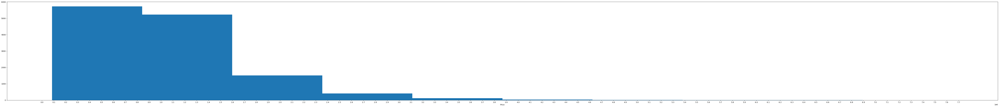

In [13]:
# PERFORMING EDA
fig, ax = plt.subplots(figsize=(100,10))
ax.set(xlabel="Price")
ax.hist(housing_data.Price)

custom_ticks = [0]  # Start with 0
current_tick = 0
while current_tick < max(housing_data.Price):
    current_tick += 100000  # Increment by 0.5
    custom_ticks.append(current_tick)
plt.xticks(custom_ticks)

plt.show()


In [14]:
update=housing_data[housing_data["Price"]<3100000]
update

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Bedroom2,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.0,1.0,202.0,NaN,NaN,Yarra,-37.79960,144.99840,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.0,0.0,156.0,79.0000,1900.0,Yarra,-37.80790,144.99340,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,3.0,0.0,134.0,150.0000,1900.0,Yarra,-37.80930,144.99440,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,3.0,1.0,94.0,NaN,NaN,Yarra,-37.79690,144.99690,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,3.0,2.0,120.0,142.0000,2014.0,Yarra,-37.80720,144.99410,Northern Metropolitan,4019.0
5,Abbotsford,129 Charles St,2,h,941000.0,S,Jellis,7/05/2016,2.0,0.0,181.0,NaN,NaN,Yarra,-37.80410,144.99530,Northern Metropolitan,4019.0
6,Abbotsford,124 Yarra St,3,h,1876000.0,S,Nelson,7/05/2016,4.0,0.0,245.0,210.0000,1910.0,Yarra,-37.80240,144.99930,Northern Metropolitan,4019.0
7,Abbotsford,98 Charles St,2,h,1636000.0,S,Nelson,8/10/2016,2.0,2.0,256.0,107.0000,1890.0,Yarra,-37.80600,144.99540,Northern Metropolitan,4019.0
8,Abbotsford,6/241 Nicholson St,1,u,300000.0,S,Biggin,8/10/2016,1.0,1.0,0.0,NaN,NaN,Yarra,-37.80080,144.99730,Northern Metropolitan,4019.0
9,Abbotsford,10 Valiant St,2,h,1097000.0,S,Biggin,8/10/2016,3.0,2.0,220.0,75.0000,1900.0,Yarra,-37.80100,144.99890,Northern Metropolitan,4019.0


In [15]:
update=update.reset_index(drop=True)

In [16]:
update.head(10)

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Bedroom2,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,3.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,3.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,3.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0
5,Abbotsford,129 Charles St,2,h,941000.0,S,Jellis,7/05/2016,2.0,0.0,181.0,NaN,NaN,Yarra,-37.8041,144.9953,Northern Metropolitan,4019.0
6,Abbotsford,124 Yarra St,3,h,1876000.0,S,Nelson,7/05/2016,4.0,0.0,245.0,210.0,1910.0,Yarra,-37.8024,144.9993,Northern Metropolitan,4019.0
7,Abbotsford,98 Charles St,2,h,1636000.0,S,Nelson,8/10/2016,2.0,2.0,256.0,107.0,1890.0,Yarra,-37.8060,144.9954,Northern Metropolitan,4019.0
8,Abbotsford,6/241 Nicholson St,1,u,300000.0,S,Biggin,8/10/2016,1.0,1.0,0.0,NaN,NaN,Yarra,-37.8008,144.9973,Northern Metropolitan,4019.0
9,Abbotsford,10 Valiant St,2,h,1097000.0,S,Biggin,8/10/2016,3.0,2.0,220.0,75.0,1900.0,Yarra,-37.8010,144.9989,Northern Metropolitan,4019.0


**Filling missing **

In [17]:
new_dataframe=update[update.columns[9:11]]
new_dataframe.head(1)

,Car,Landsize
0,1.0,202.0


In [18]:
new_dataframe["price"]=update["Price"]
new_dataframe["Buildingarea"]=update["BuildingArea"]
new_dataframe.head(1)

C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\2791815946.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_dataframe["price"]=update["Price"]
C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\2791815946.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_dataframe["Buildingarea"]=update["BuildingArea"]


,Car,Landsize,price,Buildingarea
0,1.0,202.0,1480000.0,NaN


In [19]:
new_dataframe.isna().sum()

Car               59
Landsize           0
price              0
Buildingarea    6132
dtype: int64

In [20]:
new_dataframe.dropna(inplace=True)

C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\1828885721.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_dataframe.dropna(inplace=True)


In [21]:
new_dataframe.isna().sum()

Car             0
Landsize        0
price           0
Buildingarea    0
dtype: int64

In [22]:
new_dataframe.head()

,Car,Landsize,price,Buildingarea
1,0.0,156.0,1035000.0,79.0
2,0.0,134.0,1465000.0,150.0
4,2.0,120.0,1600000.0,142.0
6,0.0,245.0,1876000.0,210.0
7,2.0,256.0,1636000.0,107.0


In [23]:
# FILLING DATA USING LINEAR REGRESSION
from sklearn.linear_model import LinearRegression
X=new_dataframe.drop("Buildingarea",axis=1)
y=new_dataframe.Buildingarea
model=LinearRegression()
model.fit(X,y)

LinearRegression()

In [24]:
update["BuildingArea"].fillna(0.0,inplace=True)
update["Price"].fillna(0.0,inplace=True)
update["Car"].fillna(0.0,inplace=True)
update["Landsize"].fillna(0.0,inplace=True)


C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\2982294365.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  update["BuildingArea"].fillna(0.0,inplace=True)
C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\2982294365.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For exam

In [25]:
for i in range(len(update)):
    if update["BuildingArea"][i] == 0.0:
        if(update["Car"][i] and update["Landsize"][i] and update["Price"][i]) != 0.0:
              lis = [update["Car"][0], update["Landsize"][0], update["Price"][0]]
              prediction = model.predict([lis])
              # prediction

              update["BuildingArea"][i] = prediction


C:\Users\mfaiq\AppData\Roaming\Python\Python312\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\3356791530.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/panda

In [26]:
update["BuildingArea"].isna().sum()

0

In [27]:
update.isna().sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Bedroom2            0
Car                 0
Landsize            0
BuildingArea        0
YearBuilt        5096
CouncilArea      1281
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

In [28]:
(update==0).sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Bedroom2           15
Car              1035
Landsize         1861
BuildingArea     1323
YearBuilt           0
CouncilArea         0
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

In [29]:
update_1=update[update["BuildingArea"]>0]

In [30]:
(update_1==0).sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Bedroom2            9
Car               472
Landsize         1023
BuildingArea        0
YearBuilt           0
CouncilArea         0
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

In [31]:
update_1=update_1.reset_index()

In [32]:
# Create a mapping of addresses to corresponding land sizes
address_landsize_map = update_1.set_index('Address')['Landsize']

# Use the mapping to fill missing values in Landsize column
# Group by Address and fill missing values in Landsize within each group
update_1['Landsize'] = update_1.groupby('Address')['Landsize'].transform(lambda x: x.fillna(method='ffill').fillna(method='bfill'))

C:\Users\mfaiq\AppData\Local\Temp\ipykernel_11760\2077359755.py:6: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  update_1['Landsize'] = update_1.groupby('Address')['Landsize'].transform(lambda x: x.fillna(method='ffill').fillna(method='bfill'))


In [33]:
update_1.head(1)

,index,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Bedroom2,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.0,1.0,202.0,92.150503,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0


In [34]:
# USE KNN TO FILL MISSING LANDSIZE VALUES
from sklearn.impute import KNNImputer

# Select features for imputation
X_impute = update_1[['Rooms', 'Price', 'Bedroom2', 'Car','Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude', 'Propertycount']]

# Initialize KNN imputer
imputer = KNNImputer(n_neighbors=5)

# Impute missing values
X_imputed = imputer.fit_transform(X_impute)

# Convert the imputed array back to a DataFrame
update_1_imputed = pd.DataFrame(X_imputed, columns=X_impute.columns)


In [35]:
update_1_imputed['Landsize'] = np.where(update_1_imputed['Landsize'] == 0, update_1_imputed['Landsize'].mean(), update_1_imputed['Landsize'])


In [36]:
((update_1_imputed==0).sum())

Rooms              0
Price              0
Bedroom2           9
Car              472
Landsize           0
BuildingArea       0
YearBuilt          0
Lattitude          0
Longtitude         0
Propertycount      0
dtype: int64

In [37]:
update_1_imputed[["Suburb", "Address", "Type", "Method", "Date", "Council_Area", "Regionname"]] = update_1[["Suburb", "Address", "Type", "Method", "Date", "CouncilArea", "Regionname"]]


# **Final datframe is updated_1_imputed**




In [38]:
update_1_imputed.head(1)

,Rooms,Price,Bedroom2,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount,Suburb,Address,Type,Method,Date,Council_Area,Regionname
0,2.0,1480000.0,2.0,1.0,202.0,92.150503,1930.8,-37.7996,144.9984,4019.0,Abbotsford,85 Turner St,h,S,3/12/2016,Yarra,Northern Metropolitan


In [45]:
# FROM HERE WE ARE PREDICTING AND VISUALING OUR DATA

from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score


features = ['Rooms', 'Bedroom2', 'Car', 'Landsize', 'BuildingArea', 'YearBuilt',
            'Lattitude', 'Longtitude', 'Propertycount']
target = 'Price'

X = update_1_imputed[features]
y = update_1_imputed[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

rf_regressor = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor.fit(X_train, y_train)

y_pred = rf_regressor.predict(X_test)

# Calculate Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)

r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

Mean Squared Error: 54000748927.88903
R^2 Score: 0.8217628874788605


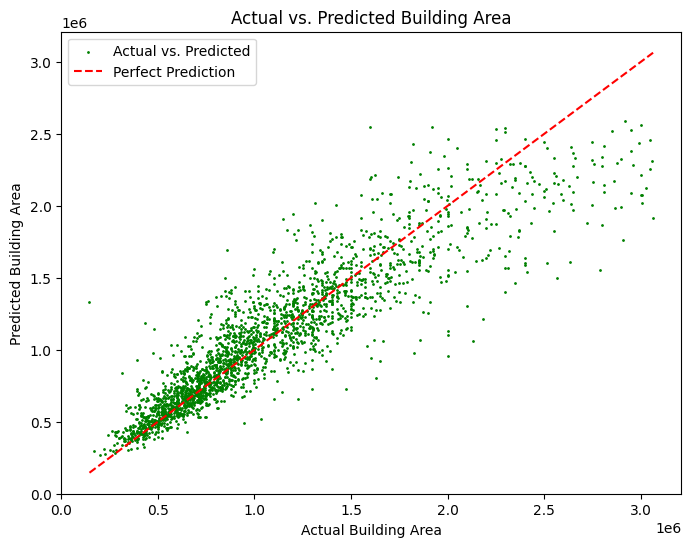

In [40]:
import matplotlib.pyplot as plt

# Plot actual vs. predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='green', label='Actual vs. Predicted', s=1)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect Prediction')
plt.xlabel('Actual Building Area')
plt.ylabel('Predicted Building Area')
plt.title('Actual vs. Predicted Building Area')
plt.legend()
#plt.ylim(0, 2000)  # Setting y-axis limit from 0 to 5000
plt.show()


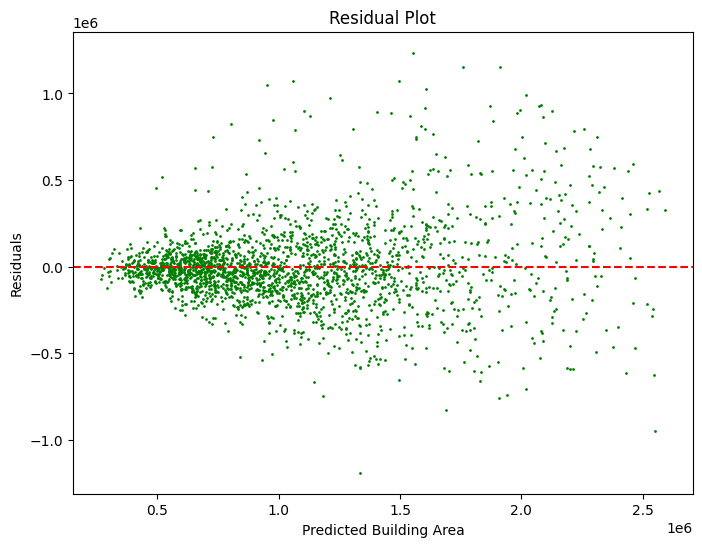

In [41]:
# Calculate residuals
residuals = y_test - y_pred

# Plot residuals
plt.figure(figsize=(8, 6))
plt.scatter(y_pred, residuals, color='green', s=1)
plt.xlabel('Predicted Building Area')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.axhline(y=0, color='red', linestyle='--')
plt.show()


In [43]:
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.histplot(residuals, kde=True, color='green')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Distribution of Residuals')
#plt.xlim(0, 600)
#plt.ylim(0, 60)
plt.show()


ModuleNotFoundError: No module named 'seaborn'

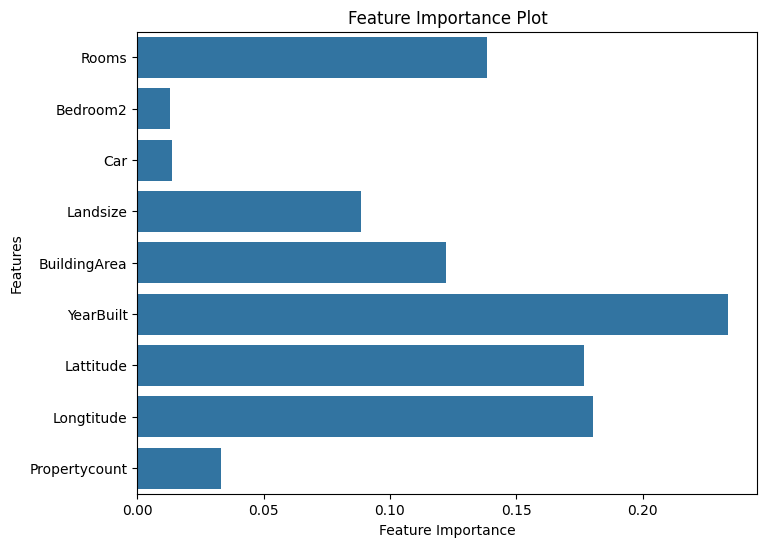

In [ ]:
# Get feature importances from the trained model
feature_importances = rf_regressor.feature_importances_

# Plot feature importances
plt.figure(figsize=(8, 6))
sns.barplot(x=feature_importances, y=X.columns)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance Plot')
plt.show()
